# Breast Cancer Dataset

In [ ]:
!pip install scikit-learn

In [ ]:
from sklearn.datasets import load_breast_cancer
from sklearn.model_selection import train_test_split
import pandas as pd
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.preprocessing import StandardScaler

In [ ]:
data = load_breast_cancer()
X = data.data
y = data.target

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [ ]:
print("Data shape:", data.data.shape)
print("Feature names:", data.feature_names)
print("Target names:", data.target_names)
print("\nDataset description:\n", data.DESCR)

Data shape: (569, 30)
Feature names: ['mean radius' 'mean texture' 'mean perimeter' 'mean area'
 'mean smoothness' 'mean compactness' 'mean concavity'
 'mean concave points' 'mean symmetry' 'mean fractal dimension'
 'radius error' 'texture error' 'perimeter error' 'area error'
 'smoothness error' 'compactness error' 'concavity error'
 'concave points error' 'symmetry error' 'fractal dimension error'
 'worst radius' 'worst texture' 'worst perimeter' 'worst area'
 'worst smoothness' 'worst compactness' 'worst concavity'
 'worst concave points' 'worst symmetry' 'worst fractal dimension']
Target names: ['malignant' 'benign']

Dataset description:
 .. _breast_cancer_dataset:

Breast cancer wisconsin (diagnostic) dataset
--------------------------------------------

**Data Set Characteristics:**

    :Number of Instances: 569

    :Number of Attributes: 30 numeric, predictive attributes and the class

    :Attribute Information:
        - radius (mean of distances from center to points on th

# Random Forest Classifier

We choose Random Forests as they are rather easily interpretable and good for feature importance analysis. We would like to see whether this has an impact on the interpreting performance of explaining models.

## Training

In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
clf = RandomForestClassifier(n_estimators=100, random_state=42)

In [ ]:
clf.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

## Evaluation

In [ ]:
y_pred = clf.predict(X_test)

In [ ]:
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')
conf_matrix = confusion_matrix(y_test, y_pred)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)
print("Confusion Matrix:\n", conf_matrix)

Accuracy: 0.9707602339181286
Precision: 0.9711000474158369
Recall: 0.9707602339181286
F1 Score: 0.970603923775359
Confusion Matrix:
 [[ 59   4]
 [  1 107]]


## Model Interpretation

### LIME

In [ ]:
!pip install lime

In [ ]:
import lime
import lime.lime_tabular

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train,
    feature_names=data.feature_names,
    class_names=data.target_names,
    mode='classification'
)

In [ ]:
instance_index = 1
instance = X_test[instance_index]
instance

array([ 1.34906186e+00,  5.11034285e-01,  1.29204314e+00,  1.31197082e+00,
       -4.27072812e-01, -7.88340504e-03,  2.56363249e-01,  8.24931429e-01,
       -8.23795402e-01, -1.11254989e+00,  1.32377819e+00, -7.82978173e-01,
        1.23644771e+00,  1.13580879e+00, -8.39173598e-01, -4.91647505e-01,
       -3.18797521e-01,  2.84949345e-01, -8.13399399e-01, -7.90488027e-01,
        1.78833753e+00,  1.78776597e-01,  1.77158878e+00,  1.72647171e+00,
       -5.42398723e-01, -1.04328486e-01,  1.03444793e-03,  1.01968394e+00,
       -5.33416957e-01, -1.00866239e+00])

In [ ]:
exp = explainer.explain_instance(
           instance,
           clf.predict_proba,
           num_features=len(data.feature_names)
)

In [ ]:
exp.show_in_notebook()

### SHAP

In [ ]:
!pip install shap

In [ ]:
import shap
import matplotlib.pyplot as plt

In [ ]:
explainer = shap.TreeExplainer(clf)

In [ ]:
shap_values = explainer.shap_values(instance)
shap_values

[array([ 2.24744399e-02,  5.29811665e-03,  3.28138353e-02,  4.85995188e-02,
         5.98038507e-05, -7.35371921e-05,  2.87717748e-02,  8.71649164e-02,
         9.69053896e-04,  1.34007889e-03,  2.19310143e-02, -1.54716456e-03,
         1.39968796e-02,  4.73714520e-02, -2.12906886e-03,  2.07090772e-03,
         5.52771283e-04, -1.35127922e-04,  2.59364893e-03,  3.69185204e-03,
         5.41160059e-02,  6.07700587e-03,  6.26735723e-02,  1.01296608e-01,
        -2.10635210e-03, -2.01930077e-04,  1.45813126e-02,  7.99330883e-02,
        -6.71429474e-03,  7.10723039e-04]),
 array([-2.24744399e-02, -5.29811665e-03, -3.28138353e-02, -4.85995188e-02,
        -5.98038507e-05,  7.35371921e-05, -2.87717748e-02, -8.71649164e-02,
        -9.69053896e-04, -1.34007889e-03, -2.19310143e-02,  1.54716456e-03,
        -1.39968796e-02, -4.73714520e-02,  2.12906886e-03, -2.07090772e-03,
        -5.52771283e-04,  1.35127922e-04, -2.59364893e-03, -3.69185204e-03,
        -5.41160059e-02, -6.07700587e-03, -6

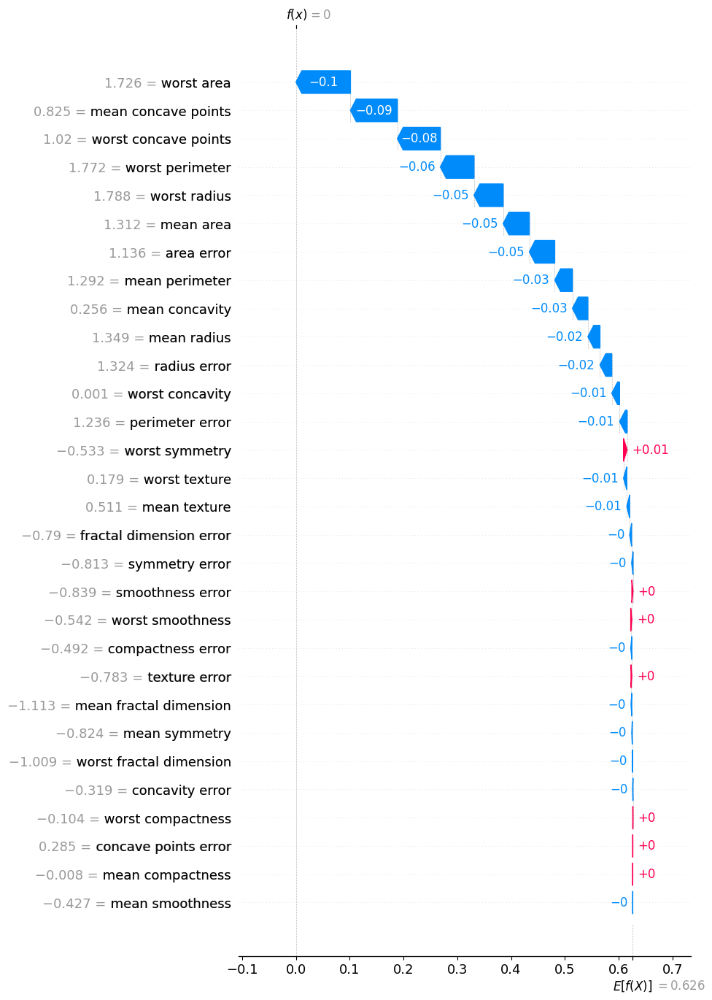

In [ ]:
shap.plots.waterfall(shap.Explanation(values=shap_values[1],
                                      base_values=explainer.expected_value[1],
                                      data=instance,
                                      feature_names=data.feature_names),
                     max_display=X_train.shape[1])

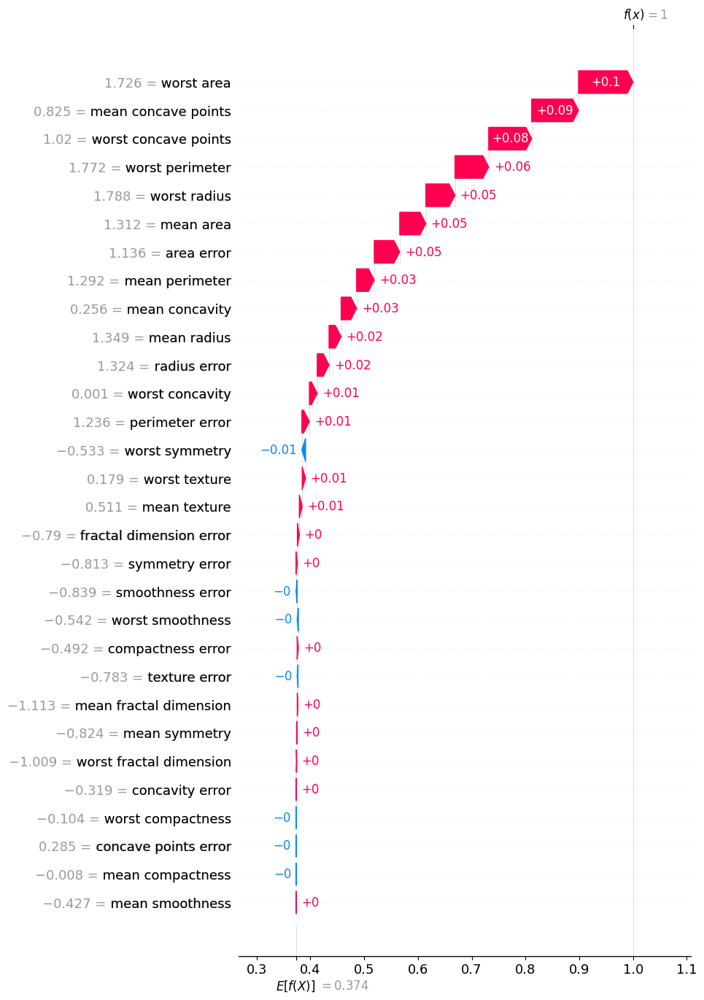

In [ ]:
shap.plots.waterfall(shap.Explanation(values=shap_values[0],
                                      base_values=explainer.expected_value[0],
                                      data=instance,
                                      feature_names=data.feature_names),
                     max_display=X_train.shape[1])

# Support Vector Machine (SVM)

We choose SVMs next, since they are known for a moderate level of interpretability (especially with linear kernels). You can understand how each feature contributes to the decision boundary, but not as straightforwardly as with tree-based models.

## Training

In [ ]:
from sklearn.svm import SVC

For SVMs, scaling should be done beforehand.

In [ ]:
svm_classifier = SVC(kernel='linear', probability=True)

In [ ]:
svm_classifier.fit(X_train, y_train)

SVC(kernel='linear', probability=True)

## Evaluation

In [ ]:
y_pred = svm_classifier.predict(X_test)

In [ ]:
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')
conf_matrix = confusion_matrix(y_test, y_pred)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)
print("Confusion Matrix:\n", conf_matrix)

Accuracy: 0.9766081871345029
Precision: 0.9766081871345029
Recall: 0.9766081871345029
F1 Score: 0.9766081871345029
Confusion Matrix:
 [[ 61   2]
 [  2 106]]


## Model Interpretation

### LIME

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train,
    feature_names=data.feature_names,
    class_names=data.target_names,
    mode='classification'
)

In [ ]:
exp = explainer.explain_instance(
    data_row=instance,
    predict_fn=svm_classifier.predict_proba
)

In [ ]:
exp.show_in_notebook()

### SHAP

In [ ]:
explainer = shap.KernelExplainer(svm_classifier.predict, shap.kmeans(X_train, 5))

In [ ]:
shap_values = explainer.shap_values(instance)
shap_values

array([-0.03038703, -0.01160065, -0.0290312 , -0.02428973, -0.00513347,
        0.02077492, -0.01810318, -0.12277337, -0.01822272,  0.        ,
       -0.11060047, -0.01055449,  0.        , -0.08112418,  0.00638375,
       -0.01214827,  0.0068217 , -0.01320469, -0.00456579, -0.04502678,
       -0.08405977, -0.03198078, -0.01144378, -0.06567536,  0.01132787,
        0.0060881 , -0.00885441, -0.02529892,  0.03919428,  0.03781004])

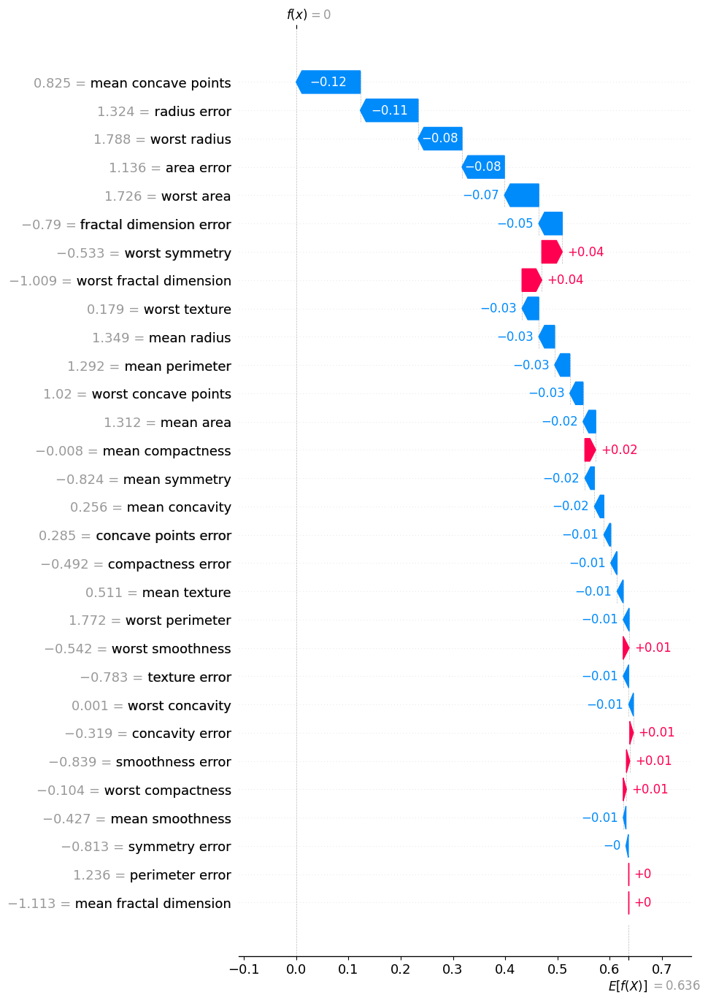

In [ ]:
shap.plots.waterfall(shap.Explanation(values=shap_values,
                                      base_values=explainer.expected_value,
                                      data=instance,
                                      feature_names=data.feature_names),
                     max_display=X_train.shape[1])

# Multi Layer Perceptron (MLP)

Finally, we choose an MLP classifier, a neural network, since they are known for being incredibly difficult to interpret.

## Training

In [ ]:
from sklearn.neural_network import MLPClassifier

In [ ]:
mlp = MLPClassifier(hidden_layer_sizes=(100,), max_iter=1000, random_state=42)

In [ ]:
mlp.fit(X_train, y_train)

MLPClassifier(max_iter=1000, random_state=42)

## Evaluation

In [ ]:
y_pred = mlp.predict(X_test)

In [ ]:
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')
conf_matrix = confusion_matrix(y_test, y_pred)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)
print("Confusion Matrix:\n", conf_matrix)

Accuracy: 0.9824561403508771
Precision: 0.9824691204186851
Recall: 0.9824561403508771
F1 Score: 0.9824263885520251
Confusion Matrix:
 [[ 61   2]
 [  1 107]]


## Model Interpretation

### LIME

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train,
    feature_names=data.feature_names,
    class_names=data.target_names,
    mode='classification'
)

In [ ]:
exp = explainer.explain_instance(
           instance,
           clf.predict_proba,
           num_features=len(data.feature_names)
)

In [ ]:
exp.show_in_notebook()

### SHAP

In [ ]:
explainer = shap.KernelExplainer(mlp.predict, shap.kmeans(X_train, 5))

In [ ]:
shap_values = explainer.shap_values(instance)
shap_values

array([ 0.        , -0.01866354, -0.0087175 , -0.03604728,  0.        ,
        0.        , -0.01234719, -0.04923325,  0.        , -0.01854977,
       -0.10195211,  0.        , -0.06337999, -0.08242822, -0.00619908,
       -0.01375951,  0.        , -0.01068858, -0.0066554 , -0.01239694,
       -0.06716506, -0.01885156, -0.09498451, -0.09849582,  0.01489053,
        0.        , -0.01060691, -0.0485497 ,  0.01359144,  0.01752162])

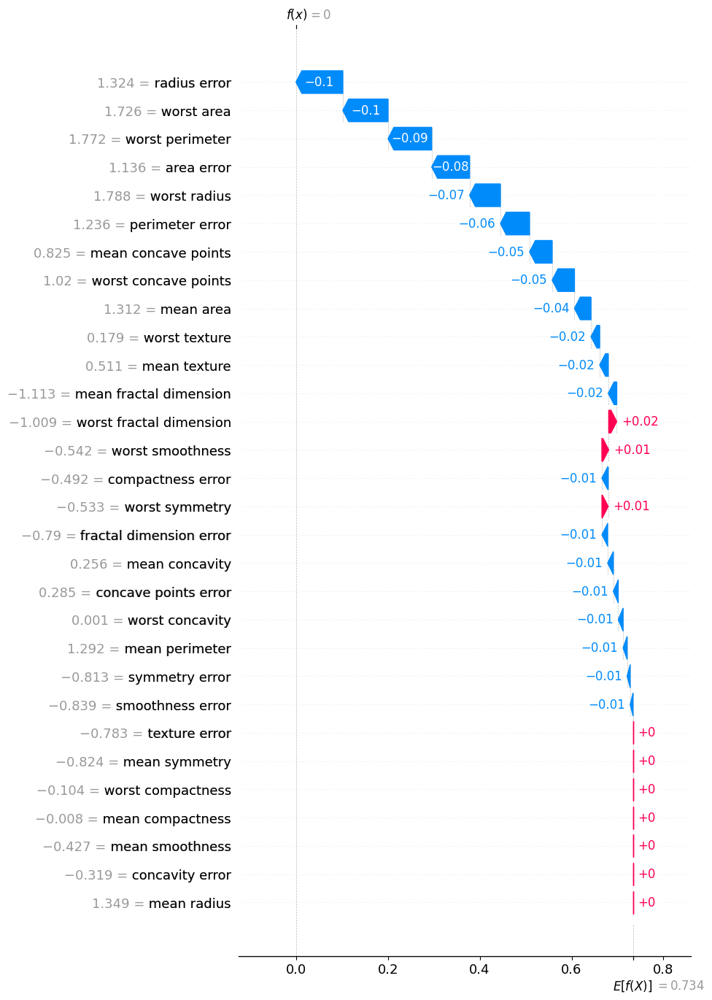

In [ ]:
shap.plots.waterfall(shap.Explanation(values=shap_values,
                                      base_values=explainer.expected_value,
                                      data=instance,
                                      feature_names=data.feature_names),
                     max_display=X_train.shape[1])

# Check for Similarities

## LIME

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train,
    feature_names=data.feature_names,
    class_names=data.target_names,
    mode='classification'
)

for i in range(20):
  instance = X_test[i]
  print("Instance ", i)

  #Random Forest LIME
  print("\nRandom Forest Classifier\n")
  probabilities = clf.predict_proba([instance])[0]
  prob_class0 = probabilities[0]
  prob_class1 = probabilities[1]

  exp = explainer.explain_instance(
           instance,
           clf.predict_proba,
           num_features=len(data.feature_names)
  )

  top_features = exp.as_list()
  top_features = sorted(top_features, key=lambda x: -np.abs(x[1]))[:5]

  print(f"Probability of Class '{data.target_names[0]}': {prob_class0:.2f}")
  print(f"Probability of Class '{data.target_names[1]}': {prob_class1:.2f}")
  print("Top 5 influential features:")
  for feature, weight in top_features:
    print(f"Feature: {feature}, Weight: {weight}")


  #SVM LIME
  print("\n\nSupport Vector Machine Classifier\n")
  probabilities = svm_classifier.predict_proba([instance])[0]
  prob_class0 = probabilities[0]
  prob_class1 = probabilities[1]

  exp = explainer.explain_instance(
           instance,
           svm_classifier.predict_proba,
           num_features=len(data.feature_names)
  )

  top_features = exp.as_list()
  top_features = sorted(top_features, key=lambda x: -np.abs(x[1]))[:5]

  print(f"Probability of Class '{data.target_names[0]}': {prob_class0:.2f}")
  print(f"Probability of Class '{data.target_names[1]}': {prob_class1:.2f}")
  print("Top 5 influential features:")
  for feature, weight in top_features:
    print(f"Feature: {feature}, Weight: {weight}")


  # MLP LIME
  print("\n\nMulti Layer Perceptron Classifier\n")
  probabilities = mlp.predict_proba([instance])[0]
  prob_class0 = probabilities[0]
  prob_class1 = probabilities[1]

  exp = explainer.explain_instance(
           instance,
           mlp.predict_proba,
           num_features=len(data.feature_names)
  )

  top_features = exp.as_list()
  top_features = sorted(top_features, key=lambda x: -np.abs(x[1]))[:5]

  print(f"Probability of Class '{data.target_names[0]}': {prob_class0:.2f}")
  print(f"Probability of Class '{data.target_names[1]}': {prob_class1:.2f}")
  print("Top 5 influential features:")
  for feature, weight in top_features:
    print(f"Feature: {feature}, Weight: {weight}")
  print("-"*100)

Instance  0

Random Forest Classifier

Probability of Class 'malignant': 0.03
Probability of Class 'benign': 0.97
Top 5 influential features:
Feature: -0.63 < worst area <= -0.34, Weight: 0.05411046225515598
Feature: -0.69 < worst perimeter <= -0.29, Weight: 0.0490285698755342
Feature: -0.67 < worst radius <= -0.27, Weight: 0.03969856395896588
Feature: -0.22 < worst concavity <= 0.59, Weight: -0.029118534990519793
Feature: -0.38 < mean concave points <= 0.68, Weight: -0.018145713951397465


Support Vector Machine Classifier

Probability of Class 'malignant': 0.16
Probability of Class 'benign': 0.84
Top 5 influential features:
Feature: -0.74 < worst texture <= -0.06, Weight: 0.07619391942942481
Feature: -0.71 < texture error <= -0.18, Weight: -0.04821216308825251
Feature: -0.67 < worst radius <= -0.27, Weight: 0.04773538391231733
Feature: -0.32 < area error <= 0.08, Weight: 0.03674186367496144
Feature: -0.24 < mean compactness <= 0.53, Weight: 0.035301554125771385


Multi Layer Perceptr

## SHAP

In [ ]:
explainer_dt = shap.TreeExplainer(clf)
explainer_svm = shap.KernelExplainer(svm_classifier.predict, shap.kmeans(X_train, 5))
explainer_mlp = shap.KernelExplainer(mlp.predict, shap.kmeans(X_train, 5))

for i in range(len(X_test)):#range(20):
  instance = X_test[i]
  print("Instance ", i)

  #Random Forest SHAP
  print("\nRandom Forest Classifier\n")
  probabilities = clf.predict_proba([instance])[0]
  prob_class0 = probabilities[0]
  prob_class1 = probabilities[1]

  shap_values = explainer_dt.shap_values(instance)

  shap_values_class1 = shap_values[1]
  top_features_class1 = np.argsort(-np.abs(shap_values_class1))[0:5]
  feature_names = np.array(data.feature_names)[top_features_class1]

  print(f"Probability of Class '{data.target_names[0]}': {prob_class0:.2f}")
  print(f"Probability of Class '{data.target_names[1]}': {prob_class1:.2f}")
  print(f"Top 5 influential features for Class '{data.target_names[1]}': {feature_names}")

  #SVM SHAP
  print("\n\nSupport Vector Machine Classifier\n")
  probabilities = svm_classifier.predict_proba([instance])[0]
  prob_class0 = probabilities[0]
  prob_class1 = probabilities[1]

  shap_values = explainer_svm.shap_values(instance)

  top_features_class1 = np.argsort(-np.abs(shap_values))[0:5]
  feature_names = np.array(data.feature_names)[top_features_class1]

  print(f"Probability of Class '{data.target_names[0]}': {prob_class0:.2f}")
  print(f"Probability of Class '{data.target_names[1]}': {prob_class1:.2f}")
  print(f"Top 5 influential features for Class '{data.target_names[1]}': {feature_names}")


  # MLP LIME
  print("\n\nMulti Layer Perceptron Classifier\n")
  probabilities = mlp.predict_proba([instance])[0]
  prob_class0 = probabilities[0]
  prob_class1 = probabilities[1]

  shap_values = explainer_mlp.shap_values(instance)

  top_features_class1 = np.argsort(-np.abs(shap_values))[0:5]
  feature_names = np.array(data.feature_names)[top_features_class1]

  print(f"Probability of Class '{data.target_names[0]}': {prob_class0:.2f}")
  print(f"Probability of Class '{data.target_names[1]}': {prob_class1:.2f}")
  print(f"Top 5 influential features for Class '{data.target_names[1]}': {feature_names}")
  print("-"*100)

Instance  0

Random Forest Classifier

Probability of Class 'malignant': 0.03
Probability of Class 'benign': 0.97
Top 5 influential features for Class 'benign': ['mean concave points' 'worst concave points' 'worst area'
 'worst perimeter' 'worst radius']


Support Vector Machine Classifier

Probability of Class 'malignant': 0.16
Probability of Class 'benign': 0.84
Top 5 influential features for Class 'benign': ['mean concave points' 'worst concavity' 'worst texture' 'mean concavity'
 'concave points error']


Multi Layer Perceptron Classifier

Probability of Class 'malignant': 0.05
Probability of Class 'benign': 0.95
Top 5 influential features for Class 'benign': ['compactness error' 'worst concave points' 'worst concavity' 'worst area'
 'worst perimeter']
----------------------------------------------------------------------------------------------------
Instance  1

Random Forest Classifier

Probability of Class 'malignant': 1.00
Probability of Class 'benign': 0.00
Top 5 influential 

# Global Interpretation

## Random Forest Classifier

In [ ]:
explainer = shap.TreeExplainer(clf)

In [ ]:
shap_values = explainer.shap_values(X_test)

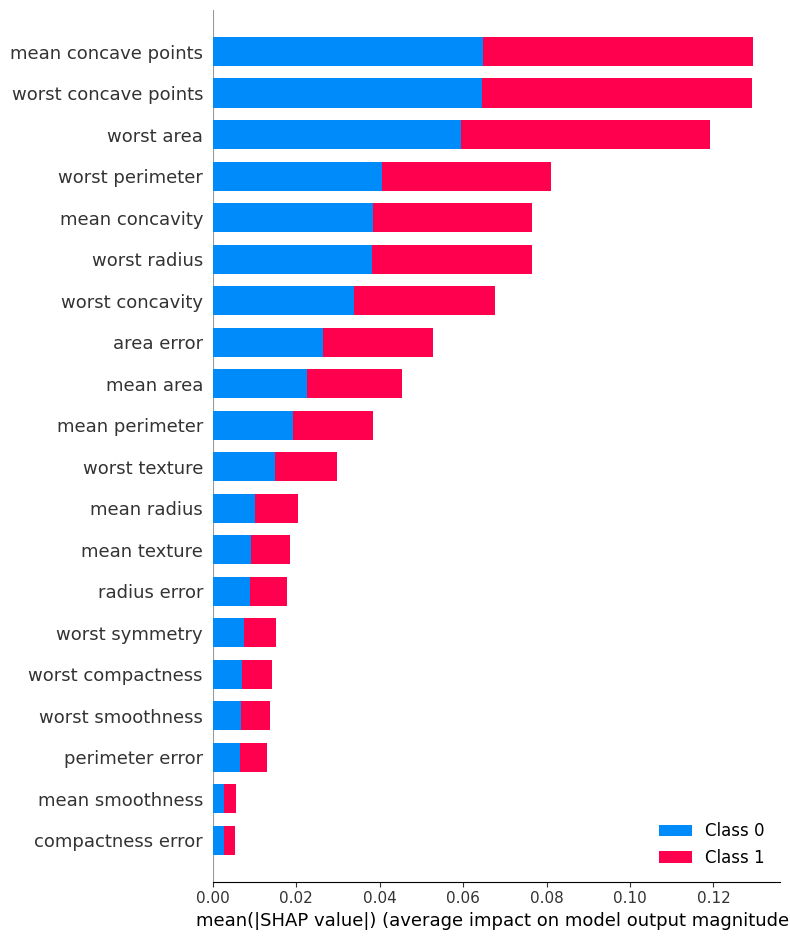

In [ ]:
shap.summary_plot(shap_values, X_test, feature_names=data.feature_names)

## Support Vector Machine (SVM)

In [ ]:
explainer = shap.KernelExplainer(svm_classifier.predict, shap.kmeans(X_train, 5))

In [ ]:
shap_values = explainer.shap_values(X_test)

  0%|          | 0/171 [00:00<?, ?it/s]

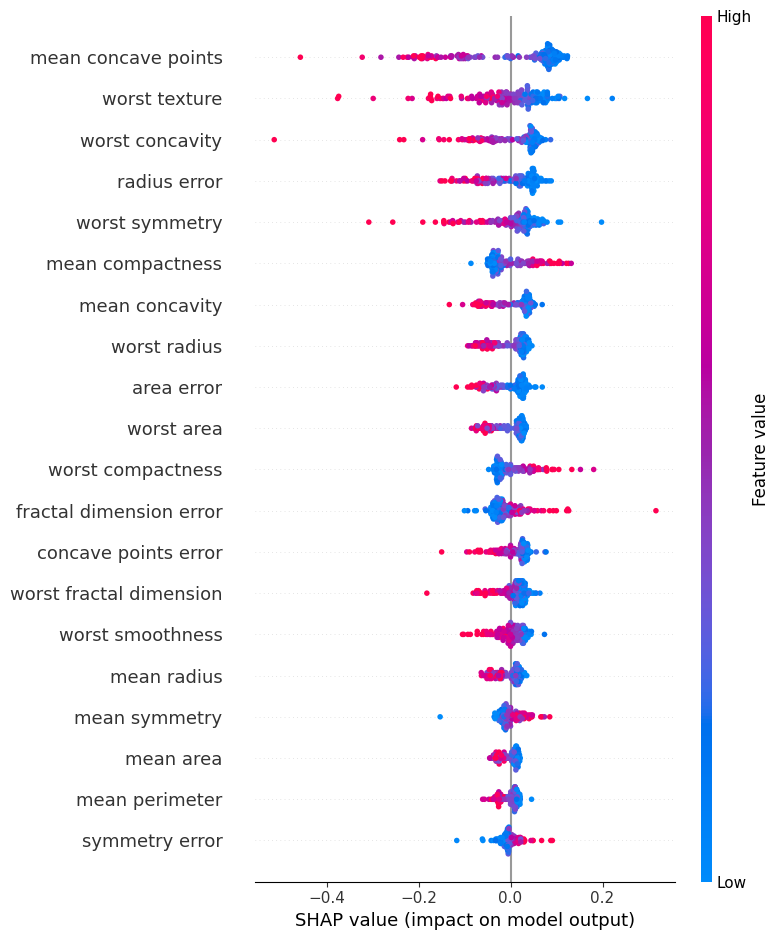

In [ ]:
shap.summary_plot(shap_values, X_test, feature_names=data.feature_names)

## Multi Layer Perceptron (MLP)

In [ ]:
explainer = shap.KernelExplainer(mlp.predict, shap.kmeans(X_train, 5))

In [ ]:
shap_values = explainer.shap_values(X_test)

  0%|          | 0/171 [00:00<?, ?it/s]

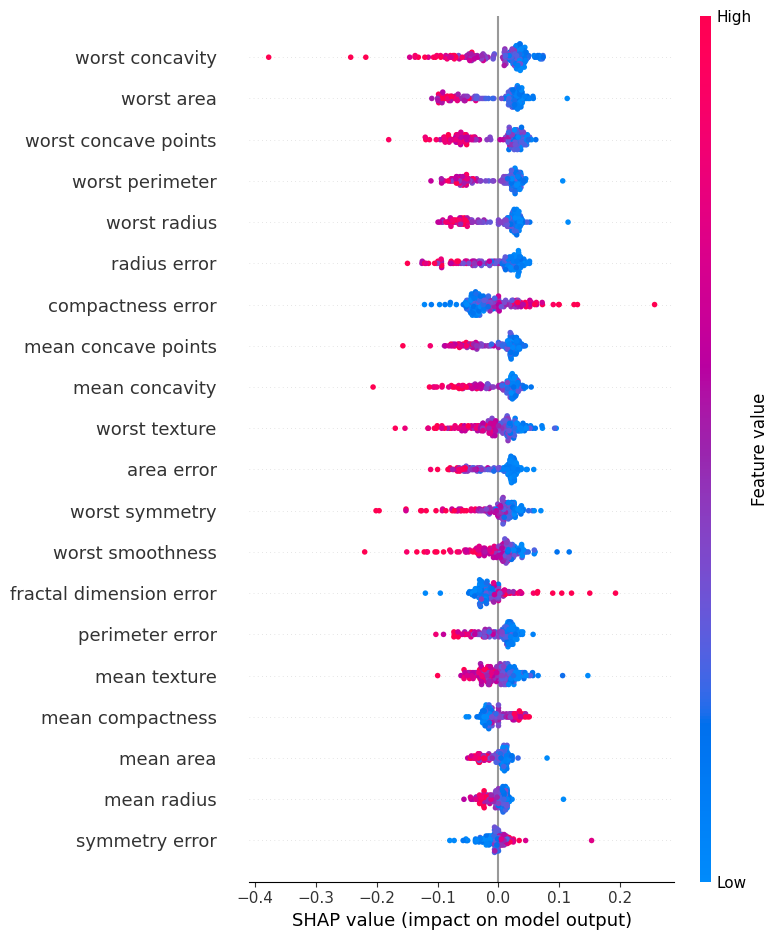

In [ ]:
shap.summary_plot(shap_values, X_test, feature_names=data.feature_names)

## Comparison

Here, we are going to compare the SHAP values (impact on the model output) between the models.

In [ ]:
explainer_rf = shap.TreeExplainer(clf)
shap_values_rf = explainer_rf.shap_values(X_test)

explainer_svm = shap.KernelExplainer(svm_classifier.predict_proba, shap.sample(X_train, 100))
shap_values_svm = explainer_svm.shap_values(X_test)

explainer_mlp = shap.KernelExplainer(mlp.predict_proba, shap.sample(X_train, 100))
shap_values_mlp = explainer_mlp.shap_values(X_test)

mean_shap_rf = np.mean(np.abs(shap_values_rf[1]), axis=0)
mean_shap_svm = np.mean(np.abs(shap_values_svm[1]), axis=0)
mean_shap_mlp = np.mean(np.abs(shap_values_mlp[1]), axis=0)

  0%|          | 0/171 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [ ]:
shap_df = pd.DataFrame({
    'Feature': data.feature_names,
    'SHAP_RF': mean_shap_rf,
    'SHAP_SVM': mean_shap_svm,
    'SHAP_MLP': mean_shap_mlp,
    'RF-SVM': np.abs(mean_shap_rf - mean_shap_svm),
    'RF-MLP': np.abs(mean_shap_rf - mean_shap_mlp),
    'SVM-MLP': np.abs(mean_shap_svm - mean_shap_mlp)
})

print(shap_df)

In [ ]:
from scipy.spatial import distance
from scipy.stats import pearsonr

euclidean_dist_rf_svm = distance.euclidean(mean_shap_rf, mean_shap_svm)
euclidean_dist_rf_mlp = distance.euclidean(mean_shap_rf, mean_shap_mlp)
euclidean_dist_svm_mlp = distance.euclidean(mean_shap_svm, mean_shap_mlp)

cosine_sim_rf_svm = 1 - distance.cosine(mean_shap_rf, mean_shap_svm)
cosine_sim_rf_mlp = 1 - distance.cosine(mean_shap_rf, mean_shap_mlp)
cosine_sim_svm_mlp = 1 - distance.cosine(mean_shap_svm, mean_shap_mlp)

corr_coef_rf_svm, _ = pearsonr(mean_shap_rf, mean_shap_svm)
corr_coef_rf_mlp, _ = pearsonr(mean_shap_rf, mean_shap_mlp)
corr_coef_svm_mlp, _ = pearsonr(mean_shap_svm, mean_shap_mlp)

print("Euclidean Distances:\nRF-SVM: {}\nRF-MLP: {}\nSVM-MLP: {}\n".format(euclidean_dist_rf_svm, euclidean_dist_rf_mlp, euclidean_dist_svm_mlp))
print("Cosine Similarities:\nRF-SVM: {}\nRF-MLP: {}\nSVM-MLP: {}\n".format(cosine_sim_rf_svm, cosine_sim_rf_mlp, cosine_sim_svm_mlp))
print("Pearson Correlation Coefficients:\nRF-SVM: {}\nRF-MLP: {}\nSVM-MLP: {}".format(corr_coef_rf_svm, corr_coef_rf_mlp, corr_coef_svm_mlp))


# User Study Preparation

This part is here to prepare 10 instances for medical experts to check. One group is given just the prediction of the model, including the feature values. Another group is given also SHAP explanations of these instances. Of the 10 instances, 3 predictions are false.

In [ ]:
for i in range(len(X_test)):
    instance = X_test[i].reshape(1, -1)
    ground_truth = y_test[i]
    prediction = mlp.predict(instance)[0]
    print(f"Ground Truth: {ground_truth}, Prediction: {prediction}")
    if not ground_truth == prediction:
        print(f"Incorrect Prediction at index: {i}")


Ground Truth: 1, Prediction: 1
Ground Truth: 0, Prediction: 0
Ground Truth: 0, Prediction: 0
Ground Truth: 1, Prediction: 1
Ground Truth: 1, Prediction: 1
Ground Truth: 0, Prediction: 0
Ground Truth: 0, Prediction: 0
Ground Truth: 0, Prediction: 0
Ground Truth: 1, Prediction: 1
Ground Truth: 1, Prediction: 1
Ground Truth: 1, Prediction: 1
Ground Truth: 0, Prediction: 0
Ground Truth: 1, Prediction: 1
Ground Truth: 0, Prediction: 0
Ground Truth: 1, Prediction: 1
Ground Truth: 0, Prediction: 0
Ground Truth: 1, Prediction: 1
Ground Truth: 1, Prediction: 1
Ground Truth: 1, Prediction: 1
Ground Truth: 0, Prediction: 0
Ground Truth: 0, Prediction: 1
Incorrect Prediction at index: 20
Ground Truth: 1, Prediction: 1
Ground Truth: 0, Prediction: 0
Ground Truth: 1, Prediction: 1
Ground Truth: 1, Prediction: 1
Ground Truth: 1, Prediction: 1
Ground Truth: 1, Prediction: 1
Ground Truth: 1, Prediction: 1
Ground Truth: 1, Prediction: 1
Ground Truth: 0, Prediction: 0
Ground Truth: 1, Prediction: 1
Groun

In [ ]:
df = pd.DataFrame(data.data, columns=data.feature_names)
df['target'] = data.target

In [ ]:
incorrect_predictions = [20, 77, 91]
correct_predictions = [8, 10, 46, 54, 106, 114, 14]

all_predictions = incorrect_predictions + correct_predictions

## Control Group

In [ ]:
for pred in all_predictions:
  instance = X_test[pred].reshape(1, -1)
  ground_truth = y_test[pred]
  prediction = mlp.predict(instance)[0]
  print(f"Prediction: {data.target_names[prediction]}")
  print(df.iloc[pred])
  print(f"Prediction correct: {pred in correct_predictions}")
  print("-"*50)

Prediction: benign
mean radius                 13.080000
mean texture                15.710000
mean perimeter              85.630000
mean area                  520.000000
mean smoothness              0.107500
mean compactness             0.127000
mean concavity               0.045680
mean concave points          0.031100
mean symmetry                0.196700
mean fractal dimension       0.068110
radius error                 0.185200
texture error                0.747700
perimeter error              1.383000
area error                  14.670000
smoothness error             0.004097
compactness error            0.018980
concavity error              0.016980
concave points error         0.006490
symmetry error               0.016780
fractal dimension error      0.002425
worst radius                14.500000
worst texture               20.490000
worst perimeter             96.090000
worst area                 630.500000
worst smoothness             0.131200
worst compactness            0.

## Experimental Group

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train,
    feature_names=data.feature_names,
    class_names=data.target_names,
    mode='classification'
)

In [ ]:
for pred in all_predictions:
  instance = X_test[pred]
  exp = explainer.explain_instance(
    data_row=instance,
    predict_fn=mlp.predict_proba
  )
  exp.show_in_notebook()
  print(df.iloc[pred])
  print(f"Prediction correct: {pred in correct_predictions}")

mean radius                 13.080000
mean texture                15.710000
mean perimeter              85.630000
mean area                  520.000000
mean smoothness              0.107500
mean compactness             0.127000
mean concavity               0.045680
mean concave points          0.031100
mean symmetry                0.196700
mean fractal dimension       0.068110
radius error                 0.185200
texture error                0.747700
perimeter error              1.383000
area error                  14.670000
smoothness error             0.004097
compactness error            0.018980
concavity error              0.016980
concave points error         0.006490
symmetry error               0.016780
fractal dimension error      0.002425
worst radius                14.500000
worst texture               20.490000
worst perimeter             96.090000
worst area                 630.500000
worst smoothness             0.131200
worst compactness            0.277600
worst concav

mean radius                  18.050000
mean texture                 16.150000
mean perimeter              120.200000
mean area                  1006.000000
mean smoothness               0.106500
mean compactness              0.214600
mean concavity                0.168400
mean concave points           0.108000
mean symmetry                 0.215200
mean fractal dimension        0.066730
radius error                  0.980600
texture error                 0.550500
perimeter error               6.311000
area error                  134.800000
smoothness error              0.007940
compactness error             0.058390
concavity error               0.046580
concave points error          0.020700
symmetry error                0.025910
fractal dimension error       0.007054
worst radius                 22.390000
worst texture                18.910000
worst perimeter             150.100000
worst area                 1610.000000
worst smoothness              0.147800
worst compactness        

mean radius                 15.370000
mean texture                22.760000
mean perimeter             100.200000
mean area                  728.200000
mean smoothness              0.092000
mean compactness             0.103600
mean concavity               0.112200
mean concave points          0.074830
mean symmetry                0.171700
mean fractal dimension       0.060970
radius error                 0.312900
texture error                0.841300
perimeter error              2.075000
area error                  29.440000
smoothness error             0.009882
compactness error            0.024440
concavity error              0.045310
concave points error         0.017630
symmetry error               0.024710
fractal dimension error      0.002142
worst radius                16.430000
worst texture               25.840000
worst perimeter            107.500000
worst area                 830.900000
worst smoothness             0.125700
worst compactness            0.199700
worst concav

mean radius                 13.000000
mean texture                21.820000
mean perimeter              87.500000
mean area                  519.800000
mean smoothness              0.127300
mean compactness             0.193200
mean concavity               0.185900
mean concave points          0.093530
mean symmetry                0.235000
mean fractal dimension       0.073890
radius error                 0.306300
texture error                1.002000
perimeter error              2.406000
area error                  24.320000
smoothness error             0.005731
compactness error            0.035020
concavity error              0.035530
concave points error         0.012260
symmetry error               0.021430
fractal dimension error      0.003749
worst radius                15.490000
worst texture               30.730000
worst perimeter            106.200000
worst area                 739.300000
worst smoothness             0.170300
worst compactness            0.540100
worst concav

mean radius                  16.020000
mean texture                 23.240000
mean perimeter              102.700000
mean area                   797.800000
mean smoothness               0.082060
mean compactness              0.066690
mean concavity                0.032990
mean concave points           0.033230
mean symmetry                 0.152800
mean fractal dimension        0.056970
radius error                  0.379500
texture error                 1.187000
perimeter error               2.466000
area error                   40.510000
smoothness error              0.004029
compactness error             0.009269
concavity error               0.011010
concave points error          0.007591
symmetry error                0.014600
fractal dimension error       0.003042
worst radius                 19.190000
worst texture                33.880000
worst perimeter             123.800000
worst area                 1150.000000
worst smoothness              0.118100
worst compactness        

mean radius                  8.196000
mean texture                16.840000
mean perimeter              51.710000
mean area                  201.900000
mean smoothness              0.086000
mean compactness             0.059430
mean concavity               0.015880
mean concave points          0.005917
mean symmetry                0.176900
mean fractal dimension       0.065030
radius error                 0.156300
texture error                0.956700
perimeter error              1.094000
area error                   8.205000
smoothness error             0.008968
compactness error            0.016460
concavity error              0.015880
concave points error         0.005917
symmetry error               0.025740
fractal dimension error      0.002582
worst radius                 8.964000
worst texture               21.960000
worst perimeter             57.260000
worst area                 242.200000
worst smoothness             0.129700
worst compactness            0.135700
worst concav

mean radius                  15.100000
mean texture                 22.020000
mean perimeter               97.260000
mean area                   712.800000
mean smoothness               0.090560
mean compactness              0.070810
mean concavity                0.052530
mean concave points           0.033340
mean symmetry                 0.161600
mean fractal dimension        0.056840
radius error                  0.310500
texture error                 0.833900
perimeter error               2.097000
area error                   29.910000
smoothness error              0.004675
compactness error             0.010300
concavity error               0.016030
concave points error          0.009222
symmetry error                0.010950
fractal dimension error       0.001629
worst radius                 18.100000
worst texture                31.690000
worst perimeter             117.700000
worst area                 1030.000000
worst smoothness              0.138900
worst compactness        

mean radius                 11.64000
mean texture                18.33000
mean perimeter              75.17000
mean area                  412.50000
mean smoothness              0.11420
mean compactness             0.10170
mean concavity               0.07070
mean concave points          0.03485
mean symmetry                0.18010
mean fractal dimension       0.06520
radius error                 0.30600
texture error                1.65700
perimeter error              2.15500
area error                  20.62000
smoothness error             0.00854
compactness error            0.02310
concavity error              0.02945
concave points error         0.01398
symmetry error               0.01565
fractal dimension error      0.00384
worst radius                13.14000
worst texture               29.26000
worst perimeter             85.51000
worst area                 521.70000
worst smoothness             0.16880
worst compactness            0.26600
worst concavity              0.28730
w

mean radius                  8.726000
mean texture                15.830000
mean perimeter              55.840000
mean area                  230.900000
mean smoothness              0.115000
mean compactness             0.082010
mean concavity               0.041320
mean concave points          0.019240
mean symmetry                0.164900
mean fractal dimension       0.076330
radius error                 0.166500
texture error                0.586400
perimeter error              1.354000
area error                   8.966000
smoothness error             0.008261
compactness error            0.022130
concavity error              0.032590
concave points error         0.010400
symmetry error               0.017080
fractal dimension error      0.003806
worst radius                 9.628000
worst texture               19.620000
worst perimeter             64.480000
worst area                 284.400000
worst smoothness             0.172400
worst compactness            0.236400
worst concav

mean radius                 13.730000
mean texture                22.610000
mean perimeter              93.600000
mean area                  578.300000
mean smoothness              0.113100
mean compactness             0.229300
mean concavity               0.212800
mean concave points          0.080250
mean symmetry                0.206900
mean fractal dimension       0.076820
radius error                 0.212100
texture error                1.169000
perimeter error              2.061000
area error                  19.210000
smoothness error             0.006429
compactness error            0.059360
concavity error              0.055010
concave points error         0.016280
symmetry error               0.019610
fractal dimension error      0.008093
worst radius                15.030000
worst texture               32.010000
worst perimeter            108.800000
worst area                 697.700000
worst smoothness             0.165100
worst compactness            0.772500
worst concav